# Pré traitement

In [2]:
import pandas as pd
import numpy as np
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
import umap
import hdbscan
from sklearn.feature_extraction.text import CountVectorizer
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from umap.umap_ import UMAP
from hdbscan import HDBSCAN
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = "notebook"
from sklearn.feature_extraction.text import CountVectorizer, ENGLISH_STOP_WORDS
from sentence_transformers import SentenceTransformer
import numpy as np
import re
import os
os.environ["TOKENIZERS_PARALLELISM"] = "false"
import json



# Pré traitement

In [3]:
# Chargement du fichier XLSX
file_path = "new_fichier_traduit.xlsx"
df = pd.read_excel(file_path, engine='openpyxl')

# Afficher les premières lignes pour vérifier
df.head()


,id,nom,date_ouverture,date_fermeture,website,email,adresse,horaires,presentation,responsables,...,longitude,adresse_complete,codepostal,telephone,visite,user_id,question1,réponse1,question2,réponse2
0,71,La loge,2012.0,NaN,www.la-loge.be,info@la-loge.be,Kluisstraat - rue de l’Ermitage 86,NaN,NaN,NaN,...,4.365647,"Kluisstraat - rue de l’Ermitage 86, 1050, Brux...",1050.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,164,W,2010.0,NaN,www.w-pantin.xyz,wladresse@gmail.com,6 avenue Weber,Sur le temps des expositions,"W was installed in the East of Paris, in Panti...","Ana Braga, Fanny Châlot, Vincent Deniel, Judit...",...,2.395739,"6 avenue Weber, 93500, Pantin, France",93500.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN
2,81,HEKLA,2013.0,2017.0,www.facebook.com/heklagalerie,heklastudio@gmail.com,50 Joseph Claes,NaN,NaN,NaN,...,4.338113,"50 Joseph Claes, 1060, Bruxelles, Belgique",1060.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN
3,79,Rosa Brux,2012.0,NaN,www.rosabrux.org,contact@rosabrux.org,RUE DE L'AUTONOMIE 9,NaN,NaN,NaN,...,4.337806,"RUE DE L'AUTONOMIE 9, 1070, Bruxelles, Belgique",1070.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,83,Greylight Projects,2009.0,NaN,greylightprojects.org,office@greylightprojects.org,Rue Brialmont 11,NaN,NaN,NaN,...,4.367350,"Rue Brialmont 11, 1210, Bruxelles, Belgique",1210.0,NaN,NaN,3.0,NaN,NaN,NaN,NaN


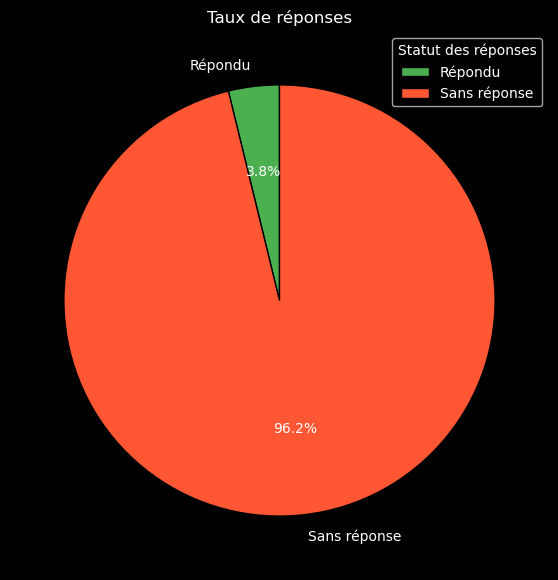

Fichier JSON 'reponses_stats.json' généré avec succès.


In [4]:
# Diagramme circulaire des réponses

# Compter les réponses non vides
total_lignes = len(df)


# Nombre total de réponses

# Espaces ayant répondu à au moins une question
espaces_ayant_repondu = len(df[(df['réponse1'].notna()) | (df['réponse2'].notna())])
# Espaces n'ayant répondu à aucune question
espaces_sans_reponse = total_lignes - espaces_ayant_repondu

# Création du dictionnaire avec les valeurs
data = {
    "Répondu": int(espaces_ayant_repondu),
    "Sans réponse": int(espaces_sans_reponse)
}


# Données pour le diagramme
labels = ['Répondu', 'Sans réponse']
values = [espaces_ayant_repondu, espaces_sans_reponse]  # Calculs des réponses
colors = ['#4CAF50', '#FF5733']  # Couleurs pour les sections

# Création du pie chart
plt.figure(figsize=(7,7))
wedges, texts, autotexts = plt.pie(values, labels=labels, autopct='%1.1f%%', 
                                    colors=colors, startangle=90, wedgeprops={'edgecolor': 'black'})

# Ajouter un titre
plt.title("Taux de réponses")

# Ajouter la légende
plt.legend(wedges, labels, title="Statut des réponses", loc="best")

# Afficher le graphique
plt.show()

# Sauvegarde en fichier JSON
with open("reponses_stats.json", "w", encoding="utf-8") as f:
    json.dump(data, f, ensure_ascii=False, indent=4)

print("Fichier JSON 'reponses_stats.json' généré avec succès.")


In [6]:
def clean_text(text):
    if pd.isna(text):
        return ""
    
    # Convertir en string
    text = str(text)
    
    # Nettoyer les marqueurs de retour à la ligne spécifiques
    text = text.replace('_*x000d*_', ' ')
    
    # Nettoyer les espaces multiples
    text = ' '.join(text.split())
    
    return text.strip()

def combine_columns(row):
    """Combine les colonnes de texte pour un espace donné sans les labels."""
    combined_text = []
    for content_type in ['activites', 'presentation', 'historique', 'réponse1', 'réponse2']:
        content = row[content_type]
        if pd.notna(content) and str(content).strip() != "":
            cleaned_text = clean_text(content)
            combined_text.append(cleaned_text)
    return " ".join(combined_text)  # Fusionner sans séparateur explicite


# Combiner les colonnes de texte pour chaque espace
df['texte_combine'] = df.apply(combine_columns, axis=1)
df_combine = df[['nom', 'texte_combine']]

# Afficher quelques exemples de texte combiné
print("\nExemples de texte combiné :")
print(df_combine[['nom', 'texte_combine']].head(10))

df_combine[['nom', 'texte_combine']].to_csv("output.csv", index=False, encoding='utf-8')
print("Fichier 'output.csv' généré.")






Exemples de texte combiné :
                        nom                                      texte_combine
0                   La loge                                                   
1                         W  W was installed in the East of Paris, in Panti...
2                     HEKLA                                                   
3                 Rosa Brux                                                   
4        Greylight Projects                                                   
5                HECTOLITER  H E C T O L I T E R is a project space for con...
6  Artists Club Coffre-Fort  In March 2012, Thibaut Espiau, Ištvan Išt Huzj...
7                      / 77  All of the activities that we will develop and...
8                    Island  Island is a non profit art space, opened in 20...
9                 Immanence  Immantique is a place of exhibition, diffusion...
Fichier 'output.csv' généré.


In [7]:


def load_and_prepare_data(df):
    processed_texts = []
    space_names = []
    
    for idx, row in df.iterrows():
        content = row['texte_combine']  # Utilisation directe de la colonne fusionnée
        if pd.notna(content) and str(content).strip() != "":
            # Nettoyer le texte
            cleaned_text = clean_text(content)
            
            # Vérifier si le texte n'est pas vide après nettoyage
            if cleaned_text:
                processed_texts.append(cleaned_text)
                space_names.append(str(row['nom']).strip())

    # Créer le DataFrame
    processed_df = pd.DataFrame({
        'nom': space_names,
        'texte': processed_texts
    })
    
    # Afficher les statistiques
    print("Statistiques :")
    print(f"Nombre total de documents : {len(processed_df)}")
    print("\nNombre d'espaces uniques :", len(processed_df['nom'].unique()))
    
    # Afficher quelques exemples pour vérification
    print("\nExemples de textes nettoyés :")
    print(processed_df['texte'].iloc[0][:200])  # Premier extrait de texte
    
    return processed_df

# Préparer les données
processed_df = load_and_prepare_data(df_combine)


Statistiques :
Nombre total de documents : 330

Nombre d'espaces uniques : 330

Exemples de textes nettoyés :
W was installed in the East of Paris, in Pantin in February 2010. The space has two very different potentials: the first level is an abbreviation space, the second working space. W aims at the quality



=== Génération du Nuage de Mots ===
Longueur totale du texte concaténé : 422076 caractères


[nltk_data] Downloading package stopwords to
[nltk_data]     /home/jadjimon/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Nombre de mots extraits : 200
Données du nuage de mots sauvegardées dans 'word_cloud_data.json'.


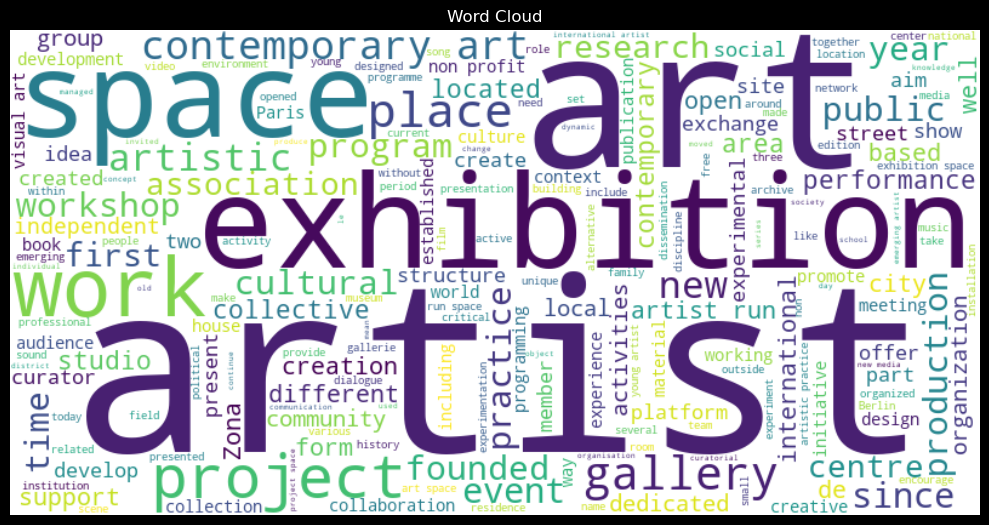

Nuage de mots sauvegardé sous forme d'image dans 'word_cloud.png'


In [9]:
# Nuage de mots et sauvegarde des données pour React
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import nltk
import json

print("\n=== Génération du Nuage de Mots ===")

# Vérifier les objets nécessaires
if 'processed_df' not in globals():
    raise NameError("Erreur : processed_df non défini. Exécutez le pipeline principal d'abord.")

if 'texte' not in processed_df.columns:
    raise KeyError("Erreur : La colonne 'texte' est absente dans processed_df.")

# Télécharger les stopwords anglais si ce n'est pas déjà fait
nltk.download('stopwords')

# Concaténer tous les textes en un seul grand texte
all_text = ' '.join(processed_df['texte'])
print(f"Longueur totale du texte concaténé : {len(all_text)} caractères")

# Définir les stopwords (mots vides) en anglais à ignorer
english_stopwords = set(stopwords.words('english'))
# Ajouter d'autres mots non pertinents si nécessaire
custom_stopwords = {'also', 'would', 'could', 'one', 'may', 'many', 'use'}
all_stopwords = english_stopwords.union(custom_stopwords)

# Créer le nuage de mots
wordcloud = WordCloud(
    width=800, 
    height=400, 
    background_color='white',
    stopwords=all_stopwords,
    contour_width=1,
    contour_color='steelblue',
    colormap='viridis',
    random_state=42,  # Pour la reproductibilité
    #max_words=100,    # Limiter à 100 mots pour éviter un JSON trop lourd
).generate(all_text)

# Extraire les mots et leurs fréquences
word_frequencies = wordcloud.words_  # Dictionnaire {mot: fréquence normalisée}
print(f"Nombre de mots extraits : {len(word_frequencies)}")

# Convertir les fréquences normalisées en une liste pour JSON
word_data = [{"word": word, "value": freq} for word, freq in word_frequencies.items()]
# Trier par fréquence décroissante (optionnel, pour React)
word_data = sorted(word_data, key=lambda x: x["value"], reverse=True)

# Sauvegarder les données dans un fichier JSON
with open("word_cloud_data.json", "w", encoding="utf-8") as f:
    json.dump(word_data, f, ensure_ascii=False, indent=4)
print("Données du nuage de mots sauvegardées dans 'word_cloud_data.json'.")

# Afficher le nuage de mots (optionnel, pour vérification)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Word Cloud")
plt.tight_layout()
plt.show()

# Sauvegarder l'image (optionnel)
wordcloud.to_file("word_cloud.png")
print("Nuage de mots sauvegardé sous forme d'image dans 'word_cloud.png'")

In [ ]:
# Créer un nouveau DataFrame avec les colonnes souhaitées de la base de départ
df_final = df[['nom', 'latitude', 'longitude', 'ville', 'pays', 'website']].copy()

# Ajouter une colonne 'texte' vide
df_final['texte'] = ""

# Pour chaque espace dans processed_df, ajouter son texte dans df_final
for _, row in processed_df.iterrows():
    mask = df_final['nom'] == row['nom']
    if any(mask):
        df_final.loc[mask, 'texte'] = row['texte']

# Afficher quelques statistiques pour vérification
print("\nStatistiques:")
print(f"Nombre total d'espaces dans df_final: {len(df_final)}")
print(f"Nombre d'espaces avec texte: {len(df_final[df_final['texte'] != ''])}")
print(f"Nombre d'espaces sans texte: {len(df_final[df_final['texte'] == ''])}")

# Maintenant on peut créer le JSON à partir de df_final
def create_geo_json(df_final):
    """
    Crée le fichier JSON avec les coordonnées des espaces et leurs textes
    """
    geo_data = []
    total_spaces = len(df_final)
    spaces_without_coords = 0
    
    for _, space_info in df_final.iterrows():
        try:
            if pd.notna(space_info['latitude']) and pd.notna(space_info['longitude']):
                space_object = {
                    "nom": str(space_info['nom']).strip(),
                    "latitude": float(space_info['latitude']),
                    "longitude": float(space_info['longitude']),
                    "ville": str(space_info['ville']) if pd.notna(space_info['ville']) else "",
                    "pays": str(space_info['pays']) if pd.notna(space_info['pays']) else "",
                    "website": str(space_info['website']) if pd.notna(space_info['website']) else "",
                    "texte": str(space_info['texte']).strip()
                }
                geo_data.append(space_object)
            else:
                print(f"Avertissement: Coordonnées manquantes pour '{space_info['nom']}'")
                spaces_without_coords += 1
        except (ValueError, TypeError) as e:
            print(f"Erreur avec les coordonnées de '{space_info['nom']}': {e}")
            spaces_without_coords += 1
    
    # Afficher les statistiques
    print(f"\nStatistiques de géolocalisation:")
    print(f"Nombre total d'espaces: {total_spaces}")
    print(f"Espaces sans coordonnées valides: {spaces_without_coords}")
    print(f"Espaces avec coordonnées valides: {len(geo_data)}")
    
    # Afficher la répartition par pays
    if geo_data:
        pays_count = {}
        for space in geo_data:
            if space['pays']:
                pays_count[space['pays']] = pays_count.get(space['pays'], 0) + 1
        print("\nRépartition par pays:")
        for pays, count in sorted(pays_count.items()):
            print(f"{pays}: {count} espaces")
    
    # Sauvegarder en JSON
    if geo_data:
        with open('data.json', 'w', encoding='utf-8') as f:
            json.dump(geo_data, f, ensure_ascii=False, indent=2)
        print(f"\nFichier JSON créé avec succès.")
        
        # Afficher quelques exemples
        print("\nExemples d'entrées du fichier JSON:")
        for entry in geo_data[:3]:
            print(json.dumps(entry, ensure_ascii=False, indent=2))
    
    return geo_data

# Créer le fichier JSON
import json
try:
    geo_data = create_geo_json(df_final)
except Exception as e:
    print(f"Erreur lors de la création du fichier JSON: {e}")
    import traceback
    traceback.print_exc()

# Implémentation du modèle
# KeyBERTInspired + MMR
# Ollama mistral

# Approche hybride 

- KeyBERTInspired + MMR pour extraire des mots-clés représentant les topics (structure analytique). 
- Passer les textes associés à chaque topic à Mistral Small 3.1 pour générer une phrase descriptive pour chaque topic (présentation narrative).
- Produire une sortie combinée qui inclut à la fois les mots-clés et les résumés narratifs pour chaque topic.


In [13]:
import pandas as pd
import numpy as np
import json
import re
import time
import asyncio
import pickle
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "2"
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance
from sklearn.feature_extraction.text import CountVectorizer
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
import openai
from openai import AsyncOpenAI

# Define custom stop words (réduite pour préserver des termes clés)
custom_stop_words = list(ENGLISH_STOP_WORDS) + [
    'the', 'a', 'an', 'les', 'la', 'le', 'les', 'des',
    'and', 'or', 'but', 'et', 'ou', 'mais',
    'in', 'on', 'at', 'to', 'for', 'of', 'with', 'by', 'from',
    'dans', 'sur', 'pour', 'de', 'par',
    'it', 'its', 'this', 'that', 'these', 'those',
    'il', 'elle', 'ils', 'elles', 'ce', 'cette', 'ces',
    'is', 'are', 'was', 'were', 'be', 'been', 'being',
    'est', 'sont', 'être',
    'etc', 'eg', 'ie', 'cf',
    'x000d', 'www', 'http', 'https',
    'extra', 'certain',
    'located', 'large', 'small',
    'old', 'new',
    'time', 'year',
    'team',
    'place', 'site',
    'run', 'open',
    'hours', 'offers', 'general', 'point', 'white',
    'saint', 'island', 'village', 'printmaking'
]

# Define text cleaning functions
def clean_word(word):
    word = word.lower()
    if 'http' in word or 'www' in word:
        return ""
    word = re.sub(r'x000d|x0002', '', word, flags=re.IGNORECASE)
    word = re.sub(r'[\r\n\t]', ' ', word)
    word = word.replace('_', ' ')
    word = re.sub(r'\b\d{1,3}\b', '', word)  # Supprime les nombres sauf les années
    word = re.sub(r'[^\w\s]', ' ', word)
    word = ' '.join(word.split())
    if (word.lower() in custom_stop_words or len(word) <= 2):
        return ""
    return word

def preprocess_text(text):
    if not isinstance(text, str):
        return ""
    text = text.lower()
    text = re.sub(r'http\S+|www\.\S+', '', text)
    text = re.sub(r'x000d|x0002', '', text, flags=re.IGNORECASE)
    text = re.sub(r'[\r\n\t]', ' ', text)
    text = re.sub(r'_+', ' ', text)
    text = re.sub(r'\b\d{1,3}\b', '', text)  # Supprime les nombres sauf les années (4 chiffres)
    text = re.sub(r'[^\w\s]', ' ', text)
    text = re.sub(r'\s+', ' ', text)
    # Normaliser les noms propres (exemple simple)
    text = re.sub(r'\b(quellcollectiv|khiasma|borgo ensemble|irmavep|artpool|autocenter|west space|datazone|immantique|h+ gallery|poctb|station mir|g39|rémy lielo|hannah théveneau|street gallery|franklin furnace|zabriskie point|general public|yarat|artellewa|ugo carrega|sea foundation|duplex100m2|place common|tilde|arprim|loop|para site|white columns|40mcube|articule|poisson river centre|printed matter|number shop|zeta|castillo corrales|edel extra|221a)\b', 'ART_ORG', text)
    text = re.sub(r'\b(after hours|fruithouse)\b', 'ART_ORG', text)
    text = re.sub(r'\b(nuremberg|lilas|paris|spain|berlin|châtillon|balatonboglár|lebanese|orléans)\b', 'CITY', text)
    text = re.sub(r'\b(salaisons|lower space|saint paul trois châteaus)\b', 'ART_ORG', text)
    words = text.split()
    words = [w for w in words if w not in custom_stop_words and len(w) > 2]
    return ' '.join(words).strip()

def clean_topic_names(topic_model):
    cleaned_topics = {}
    for topic_id, topic_info in topic_model.get_topics().items():
        seen_words = set()
        cleaned_words = []
        for word, score in topic_info:
            cleaned_word = clean_word(word)
            if cleaned_word and cleaned_word.lower() not in seen_words:
                words_in_phrase = set(cleaned_word.lower().split())
                if not words_in_phrase.intersection(seen_words):
                    if score > 0.01:
                        cleaned_words.append((cleaned_word, score))
                        seen_words.update(words_in_phrase)
        cleaned_topics[topic_id] = cleaned_words[:5]
    return cleaned_topics

# Load and preprocess data
processed_df['processed_text'] = processed_df['texte'].apply(preprocess_text)
processed_df['word_count'] = processed_df['processed_text'].apply(lambda x: len(x.split()))
processed_df = processed_df[processed_df['word_count'] >= 20].copy()  # Increased from 5 to 10
print(f"Nombre de documents après filtrage (longueur >= 20 mots) : {len(processed_df)}")
docs = processed_df['processed_text'].tolist()

# Cache embeddings
embedding_model = SentenceTransformer('paraphrase-multilingual-MiniLM-L12-v2')
embedding_cache_file = 'embeddings_cache.pkl'
if os.path.exists(embedding_cache_file):
    with open(embedding_cache_file, 'rb') as f:
        embeddings = pickle.load(f)
else:
    embeddings = embedding_model.encode(docs, show_progress_bar=True)
    with open(embedding_cache_file, 'wb') as f:
        pickle.dump(embeddings, f)

# Step 1: Configure BERTopic with KeyBERTInspired + MMR
representation_model_keybert = {
    "main": KeyBERTInspired(top_n_words=15),
    "mmr": MaximalMarginalRelevance(diversity=0.5)
}

umap_model = UMAP(
    n_neighbors=8,  # Reduced from 30 to 15
    n_components=5,
    min_dist=0.0,
    metric='cosine',
    random_state=42
)
hdbscan_model = HDBSCAN(
    min_cluster_size=2,  # Reduced from 3 to 2
    min_samples=1,  # Reduced from 2 to 1
    metric='euclidean',
    cluster_selection_method='eom',
    prediction_data=True
)
vectorizer_model = CountVectorizer(
    stop_words=custom_stop_words,
    ngram_range=(1, 3),
    preprocessor=preprocess_text,
    min_df=3,
    max_df=0.70,
    token_pattern=r'(?u)\b[a-zA-Z]{3,}\b'
)

topic_model_keybert = BERTopic(
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model,
    representation_model=representation_model_keybert,
    min_topic_size=2,  # Aligned with min_cluster_size
    top_n_words=10,
    calculate_probabilities=True,
    verbose=True
)

# Train KeyBERTInspired model
topics_keybert, probs_keybert = topic_model_keybert.fit_transform(docs, embeddings=embeddings)
print("\nTopics assignés avant réduction :")
print(pd.Series(topics_keybert).value_counts())

# Réduire les topics
topic_model_keybert.reduce_topics(docs, nr_topics="auto")
print("\nTopics assignés après réduction :")
print(pd.Series(topic_model_keybert.topics_).value_counts())

# Mettre à jour les topics dans processed_df après réduction
processed_df['topic_keybert'] = topic_model_keybert.topics_
processed_df['topic_probability_keybert'] = np.max(probs_keybert, axis=1) if isinstance(probs_keybert, np.ndarray) else 1.0

cleaned_topics_keybert = clean_topic_names(topic_model_keybert)

# Step 2: Group texts by topic for Mistral summarization
topic_texts = {}
for topic_id in set(topic_model_keybert.topics_):
    if topic_id != -1:  # Exclude outliers
        topic_docs = processed_df[processed_df['topic_keybert'] == topic_id]['texte'].tolist()
        topic_texts[topic_id] = " ".join(topic_docs[:1000])[:2000]  # Limit text length for API

# Step 3: Configure Mistral Small 3.1 client and generate summaries
prompt = "Summarize the main theme in one concise sentence (max 15 words), avoiding specific names, places, and vague regional references:"

async def generate_summary(client, topic_id, text, prompt, max_attempts=3):
    for attempt in range(max_attempts):
        try:
            response = await client.chat.completions.create(
                model='mistral-small3.1:latest',
                messages=[
                    {"role": "system", "content": prompt},
                    {"role": "user", "content": text}
                ],
                max_tokens=15,
                temperature=0.3
            )
            return topic_id, response.choices[0].message.content.strip()
        except Exception as e:
            if attempt < max_attempts - 1:
                print(f"Tentative {attempt+1} échouée pour topic {topic_id}: {e}. Nouvelle tentative après {2**(attempt+1)}s...")
                await asyncio.sleep(2**(attempt+1))
            else:
                print(f"Échec après {max_attempts} tentatives pour topic {topic_id}: {e}")
                return topic_id, "No summary available due to API error."

async def generate_all_summaries(topic_texts, prompt):
    async with AsyncOpenAI(base_url='http://localhost:11434/v1', api_key='ollama') as client:
        tasks = []
        for topic_id, text in topic_texts.items():
            if text.strip():
                tasks.append(generate_summary(client, topic_id, text, prompt))
            else:
                tasks.append(asyncio.sleep(0, result=(topic_id, "No summary available due to insufficient text.")))
        results = await asyncio.gather(*tasks, return_exceptions=True)
        return dict(results)

# Exécuter dans Jupyter Notebook avec await
topic_summaries = await generate_all_summaries(topic_texts, prompt)

# Step 4: Combine results
hybrid_results = {}
for topic_id in cleaned_topics_keybert:
    if topic_id != -1:
        keywords = [word for word, _ in cleaned_topics_keybert[topic_id]]
        summary = topic_summaries.get(topic_id, "No summary generated.")
        hybrid_results[topic_id] = {
            "keywords": keywords,
            "summary": summary
        }

# Display results
print("\n=== Hybrid Pipeline Results ===")
for topic_id, result in hybrid_results.items():
    print(f"\nTopic {topic_id}:")
    print(f"Keywords: {', '.join(result['keywords'])}")
    print(f"Summary: {result['summary']}")

# Save results to JSON
with open('hybrid_topics.json', 'w', encoding='utf-8') as f:
    json.dump(hybrid_results, f, ensure_ascii=False, indent=4)
print("\nHybrid topics (keywords + summaries) saved to 'hybrid_topics.json'.")

# Générer un dictionnaire avec le nombre de documents par topic
topic_counts = {}
for topic in set(topic_model_keybert.topics_):
    if topic != -1:  # Exclure les outliers
        count = len(processed_df[processed_df['topic_keybert'] == topic])
        topic_counts[str(topic)] = {"texte": count}

# Sauvegarder au format JSON
with open('topic_analysis.json', 'w', encoding='utf-8') as f:
    json.dump(topic_counts, f, ensure_ascii=False, indent=4)
print("Nombre de documents par topic sauvegardé dans 'topic_analysis.json'.")

# Analyze topic -1
topic_info_keybert = topic_model_keybert.get_topic_info()
if -1 in topic_info_keybert['Topic'].values:
    topic_minus_1_count = topic_info_keybert[topic_info_keybert['Topic'] == -1]['Count'].iloc[0]
    print(f"\nPourcentage de documents dans le topic -1 : {(topic_minus_1_count / len(processed_df) * 100):.2f}%")
    topic_minus_1_docs = processed_df[processed_df['topic_keybert'] == -1][['texte', 'processed_text']].head(5)
    print("Exemples de documents dans le topic -1 :")
    for i, row in topic_minus_1_docs.iterrows():
        print(f"Document {i+1}: {row['texte'][:200]}... (Pré-traité: {row['processed_text'][:100]}...)")
    processed_df[processed_df['topic_keybert'] == -1][['texte', 'processed_text']].to_csv('topic_minus_1_hybrid.csv', index=False)
    print("Documents du topic -1 exportés dans 'topic_minus_1_hybrid.csv'.")
else:
    print("\nAucun document dans le topic -1.")

# Visualize topics
print("\nTopic Information:")
print(topic_info_keybert)

# Sauvegarde de processed_df
processed_df_backup = processed_df.copy()
processed_df_backup.to_csv('processed_df_backup.csv', index=False)
print("Sauvegarde de processed_df effectuée dans 'processed_df_backup.csv'.")

# Ajout de l'impression des counts initiaux
print("\nCounts initiaux des topics après le modèle :")
print(processed_df['topic_keybert'].value_counts())

Nombre de documents après filtrage (longueur >= 20 mots) : 307


2025-05-10 19:39:05,289 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-05-10 19:39:11,418 - BERTopic - Dimensionality - Completed ✓
2025-05-10 19:39:11,420 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-05-10 19:39:11,499 - BERTopic - Cluster - Completed ✓
2025-05-10 19:39:11,502 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-05-10 19:39:15,538 - BERTopic - Representation - Completed ✓
2025-05-10 19:39:15,908 - BERTopic - Topic reduction - Reducing number of topics
2025-05-10 19:39:15,927 - BERTopic - Representation - Fine-tuning topics using representation models.



Topics assignés avant réduction :
-1     31
 0      6
 1      6
 2      6
 3      6
       ..
 91     2
 92     2
 93     2
 94     2
 95     2
Name: count, Length: 97, dtype: int64


2025-05-10 19:39:18,581 - BERTopic - Representation - Completed ✓
2025-05-10 19:39:18,583 - BERTopic - Topic reduction - Reduced number of topics from 97 to 69



Topics assignés après réduction :
 0     103
-1      31
 1       6
 2       5
 3       5
      ... 
 63      2
 64      2
 65      2
 66      2
 67      2
Name: count, Length: 69, dtype: int64

=== Hybrid Pipeline Results ===

Topic 0:
Keywords: art org, projects, arts
Summary: The main theme is fostering artistic collaboration and growth through shared, non-com

Topic 1:
Keywords: pierre, mainly, spaces art, steps, italy
Summary: Artist-run spaces foster unique, boundary-pushing contemporary art experiences.

Topic 2:
Keywords: century, paintings, museum, concrete, houses
Summary: Art and community can thrive even under restrictive conditions.

Topic 3:
Keywords: fashion, press, poetry, took, presented
Summary: Contemporary art fosters cultural dialogue and nurtures artistic innovation.

Topic 4:
Keywords: popular, going, editions, narrative, submissions
Summary: The main theme is fostering community engagement through shared information and cultural experiences.

Topic 5:
Keywords: 

# Présentation des résultats 

In [15]:
def evaluate_topic_quality(topic_model, cleaned_topics, texts):
    # Obtenir les mots-clés nettoyés de chaque topic
    topic_words = cleaned_topics
    
    # Vérifier la diversité des topics
    unique_words = set()
    total_words = 0
    
    for topic in topic_words.values():
        words = [word for word, _ in topic]  # Extraire les mots-clés
        unique_words.update(words)
        total_words += len(words)
    
    topic_diversity = len(unique_words) / total_words if total_words > 0 else 0  # Normalisation correcte
    
    # Calculer la représentativité des topics
    topic_sizes = topic_model.get_topic_freq()
    topic_sizes = topic_sizes[topic_sizes["Topic"] != -1]  # Exclure les outliers
    
    topic_coverage = (len(texts) - topic_sizes["Count"].sum()) / len(texts) if not topic_sizes.empty else 0
    
    print("\n=== ÉVALUATION DES TOPICS ===")
    print(f"Diversité des topics : {topic_diversity:.3f} (idéalement proche de 1)")
    print(f"Couverture des topics : {topic_coverage:.3f} (idéalement proche de 0)")
    
    return {"topic_diversity": topic_diversity, "topic_coverage": topic_coverage}

# Appel de la fonction
quality_metrics = evaluate_topic_quality(topic_model_keybert, cleaned_topics_keybert, processed_df['texte'].tolist())

# Sauvegarder les métriques pour l'application React (facultatif)
with open('quality_metrics.json', 'w', encoding='utf-8') as f:
    json.dump(quality_metrics, f, ensure_ascii=False, indent=4)
print("Métriques de qualité sauvegardées dans 'quality_metrics.json'.")




=== ÉVALUATION DES TOPICS ===
Diversité des topics : 0.913 (idéalement proche de 1)
Couverture des topics : 0.101 (idéalement proche de 0)
Métriques de qualité sauvegardées dans 'quality_metrics.json'.


- Diversité des topics : 0.913 ✅ → C’est une bonne valeur, proche de 1, ce qui signifie que Les topics sont très distincts et variés, avec une redondance minimale. Cette valeur est proche de l'idéal (1), confirmant la qualité de votre modèle pour une analyse fine.
- Couverture des topics : 0.101 ✅ → Idéalement, on voudrait que ça soit plus bas (proche de 0) ou inférieur à 10%, ce qui signifierait que la majorité des textes sont bien couverts par les topics. La valeur 0,101 signifie que 89,9 % des textes sont bien couverts par les 68 topics, ce qui répresente un succès adapté à une analyse fine.


In [16]:
import pandas as pd
import json
import plotly.express as px

# Section 5 : Analyse des Relations entre Topics
###########################################

print("\n=== Analyse des Relations entre Topics ===")

# Vérifier les objets nécessaires
if 'processed_df' not in globals() or 'topic_model_keybert' not in globals():
    raise NameError("Erreur : processed_df ou topic_model_keybert non définis. Exécutez le pipeline principal d'abord.")

# Sauvegarder une copie de processed_df avant toute modification
processed_df_backup = processed_df.copy()
print("Sauvegarde de processed_df effectuée avant analyse.")

# Définir cleaned_topics_keybert si non fourni (utiliser le modèle)
cleaned_topics_keybert = topic_model_keybert.get_topics()

# Définir les topics valides basés sur la sortie du modèle (0 à 67 dans votre cas)
valid_topics = list(range(max(processed_df['topic_keybert'].unique()) + 1))  # Dynamique, inclut tous les topics
print(f"Topics valides dans le modèle (hors -1) : {valid_topics}")

# Vérifier les counts initiaux
print("Nombre de documents par topic dans processed_df :")
print(processed_df['topic_keybert'].value_counts())

# Vérifier les topics dans processed_df
print("Vérification des topics dans processed_df...")
current_topics = sorted(processed_df['topic_keybert'].unique())
print(f"Topics uniques dans processed_df : {current_topics}")

# 1. Analyse des relations entre topics
def analyze_topic_relationships(df, cleaned_topics):
    print("\nAnalyse détaillée des topics :")
    for topic in sorted(df['topic_keybert'].unique()):
        if topic != -1 and topic in cleaned_topics:
            print(f"\nTopic {topic}:")
            keywords = [word for word, _ in cleaned_topics.get(topic, [])][:5]
            print(f"Mots-clés: {', '.join(keywords)}")
            print("Exemples d'espaces contribuant à ce topic :")
            examples = df[df['topic_keybert'] == topic]['nom'].head(3).tolist()
            if examples:
                print(", ".join(examples))
            else:
                print("Aucun espace disponible.")

# 2. Création d'une visualisation interactive (Sunburst avec noms au survol)
def create_interactive_topic_mapping(df, cleaned_topics):
    topic_data = []
    
    # Stocker les données pour le fichier JSON des associations topics-espaces
    topics_spaces_data = {}
    
    for topic in sorted(df['topic_keybert'].unique()):
        if topic != -1 and topic in cleaned_topics:
            keywords = [word for word, _ in cleaned_topics.get(topic, [])][:3]
            topic_docs = df[df['topic_keybert'] == topic]
            spaces = topic_docs['nom'].head(5).tolist()  # Augmenté à 5 espaces par topic
            
            # Stocker les espaces pour ce topic
            topics_spaces_data[str(topic)] = spaces
            
            topic_data.append({
                'Topic': f"Topic {topic}",
                'Count': len(topic_docs),
                'Keywords': ', '.join(keywords),
                'Spaces': ', '.join(spaces) if spaces else "Aucun espace"
            })
    
    # Enregistrer les associations topics-espaces dans un fichier JSON
    with open('topics_spaces.json', 'w', encoding='utf-8') as f:
        json.dump(topics_spaces_data, f, ensure_ascii=False, indent=4)
    print("Associations topics-espaces sauvegardées dans 'topics_spaces.json'.")
    
    topic_df = pd.DataFrame(topic_data)
    # Vérifier les données avant le graphique
    print("\nDonnées pour le Sunburst :")
    print(topic_df[['Topic', 'Count', 'Keywords', 'Spaces']])
    
    fig = px.sunburst(
        topic_df,
        path=['Topic'],
        values='Count',
        hover_data=['Keywords', 'Spaces'],
        width=500,
        height=500
    )
    fig.update_layout(
        title="Mapping des Topics",
        legend_title="Topic ID",
        legend=dict(x=0.85, y=0.85)
    )
    fig.write_html("topic_mapping.html")
    print("Graphique Sunburst sauvegardé dans 'topic_mapping.html'.")
    return fig

# 3. Préparer le fichier d'analyse des topics complet
def save_topic_analysis(df, cleaned_topics, hybrid_topics=None):
    # Calculer le nombre de documents par topic
    topic_counts = df.groupby('topic_keybert').size().reset_index(name='Count')
    topic_counts = topic_counts[topic_counts['topic_keybert'] != -1]
    
    # Préparation des données pour le fichier topic_analysis.json
    topic_analysis = {}
    for _, row in topic_counts.iterrows():
        topic_id = int(row['topic_keybert'])
        topic_analysis[str(topic_id)] = {
            'texte': int(row['Count'])
        }
    
    # Sauvegarder le fichier topic_analysis.json (plus simple)
    with open('topic_analysis.json', 'w', encoding='utf-8') as f:
        json.dump(topic_analysis, f, ensure_ascii=False, indent=4)
    print("Analyse des topics (comptages) sauvegardée dans 'topic_analysis.json'.")
    
    # Préparer aussi un fichier Excel plus détaillé (optionnel)
    data = []
    for _, row in topic_counts.iterrows():
        topic = int(row['topic_keybert'])
        if topic in cleaned_topics:
            keywords = [word for word, _ in cleaned_topics.get(topic, [])][:5]
            summary = hybrid_topics.get(str(topic), {}).get("summary", "Pas de résumé disponible") if hybrid_topics else "Pas de résumé disponible"
            
            # Récupérer les espaces liés à ce topic
            topic_spaces = df[df['topic_keybert'] == topic]['nom'].head(3).tolist()
            
            data.append({
                'Topic': topic,
                'Count': row['Count'],
                'Keywords': ', '.join(keywords),
                'Summary': summary,
                'Spaces': ', '.join(topic_spaces) if topic_spaces else "Aucun espace"
            })
    
    df_analysis = pd.DataFrame(data)
    output_file = 'topic_analysis_details.xlsx'
    df_analysis.to_excel(output_file, index=False, engine='openpyxl')
    print(f"Analyse détaillée des topics sauvegardée dans '{output_file}'.")

# 4. Exécuter les analyses
try:
    # Charger les résumés de topics s'ils existent
    hybrid_topics = None
    try:
        with open('hybrid_topics.json', 'r', encoding='utf-8') as f:
            hybrid_topics = json.load(f)
        print("Fichier hybrid_topics.json chargé avec succès.")
    except Exception as e:
        print(f"Impossible de charger hybrid_topics.json: {e}")
    
    analyze_topic_relationships(processed_df, cleaned_topics_keybert)
    fig = create_interactive_topic_mapping(processed_df, cleaned_topics_keybert)
    save_topic_analysis(processed_df, cleaned_topics_keybert, hybrid_topics)
except Exception as e:
    print(f"Erreur lors de l'exécution : {e}")

# Afficher le graphique Sunburst (optionnel dans Jupyter)
fig.show()


=== Analyse des Relations entre Topics ===
Sauvegarde de processed_df effectuée avant analyse.
Topics valides dans le modèle (hors -1) : [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67]
Nombre de documents par topic dans processed_df :
topic_keybert
 0     103
-1      31
 1       6
 2       5
 3       5
      ... 
 63      2
 64      2
 65      2
 66      2
 67      2
Name: count, Length: 69, dtype: int64
Vérification des topics dans processed_df...
Topics uniques dans processed_df : [-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67]
Fichier hybrid_topics.json ch

Graphique interactif :
Le graphique interactif de type Sunburst te permet de visualiser la répartition des topics dans tes données, avec des informations sur le nombre de documents par topic et les mots-clés associés.

In [18]:
import pandas as pd
import plotly
from bertopic import BERTopic

# Section 4 : Visualisations Interactives
print("\n=== Visualisations Interactives ===")

# Vérifier les objets nécessaires
if 'topic_model_keybert' not in globals() or 'processed_df' not in globals():
    raise NameError("Erreur : topic_model_keybert ou processed_df non définis. Exécutez le pipeline principal d'abord.")

# Vérifier les données
print("Vérification des données :")
print(f"Nombre de documents dans processed_df: {len(processed_df)}")
print(f"Nombre de topics dans topic_model_keybert: {len(topic_model_keybert.topics_)}")
print(f"Valeurs manquantes dans processed_df['texte']: {processed_df['texte'].isna().sum()}")

# Aligner les indices
processed_df = processed_df.reset_index(drop=True)

# 1. Intertopic Distance Map
print("Génération de la carte des distances entre topics...")
topic_viz = topic_model_keybert.visualize_topics(
    title="Carte des Distances entre Topics",
    width=800,
    height=600
)
topic_viz.show()
topic_viz.write_html("intertopic_distance_map.html")
print("Sauvegardé dans 'intertopic_distance_map.html'.")
topic_data = topic_model_keybert.get_topic_info()[['Topic', 'Count', 'Name']]
topic_data.to_json("intertopic_distance_data.json", orient='records', indent=4)
print("Données sauvegardées dans 'intertopic_distance_data.json'.")

# 2. Topic Hierarchy
print("Génération de la hiérarchie des topics...")
hierarchy_viz = topic_model_keybert.visualize_hierarchy(
    title="Hiérarchie des Topics",
    width=800,
    height=600
)
hierarchy_viz.show()
hierarchy_viz.write_html("topic_hierarchy.html")
print("Sauvegardé dans 'topic_hierarchy.html'.")

# 3. Topic Distribution
print("Génération de la distribution des topics...")
barchart_viz = topic_model_keybert.visualize_barchart(
    top_n_topics=20,
    title="Distribution des Mots-clés par Topic",
    width=800,
    height=600
)
barchart_viz.show()
barchart_viz.write_html("topic_distribution.html")
print("Sauvegardé dans 'topic_distribution.html'.")

# 4. Heatmap des similarités entre topics (remplacement)
print("Génération de la heatmap des similarités entre topics...")
heatmap_viz = topic_model_keybert.visualize_heatmap(
    #n_clusters=5,  # Regrouper les topics en 5 clusters pour plus de lisibilité
    #top_n_topics=20,  # Limiter à 20 topics (ajuster si nécessaire)
    title="Similarité entre Topics",
    width=800,
    height=600
)
heatmap_viz.show()
heatmap_viz.write_html("topic_similarity_heatmap.html")
print("Sauvegardé dans 'topic_similarity_heatmap.html'.")



=== Visualisations Interactives ===
Vérification des données :
Nombre de documents dans processed_df: 307
Nombre de topics dans topic_model_keybert: 307
Valeurs manquantes dans processed_df['texte']: 0
Génération de la carte des distances entre topics...


Sauvegardé dans 'intertopic_distance_map.html'.
Données sauvegardées dans 'intertopic_distance_data.json'.
Génération de la hiérarchie des topics...


Sauvegardé dans 'topic_hierarchy.html'.
Génération de la distribution des topics...


Sauvegardé dans 'topic_distribution.html'.
Génération de la heatmap des similarités entre topics...


Sauvegardé dans 'topic_similarity_heatmap.html'.


- Intertopic Distance Map :
Cette visualisation affiche une carte 2D des distances entre les 68 topics, basée sur leurs embeddings. Les topics proches sur la carte sont sémantiquement similaires, reflétant des mots-clés et des concepts partagés.
- Topic Hierarchy
Cette visualisation présente un dendrogramme qui organise les topics en une hiérarchie, montrant leurs relations de similarité. Les topics regroupés sous une même branche partagent des caractéristiques communes, facilitant l’identification de sous-groupes.
- Topic Distribution : 
Cette visualisation montre un graphique à barres des 20 premiers topics, avec les mots-clés les plus représentatifs et leurs fréquences relatives, permettant d’identifier les termes dominants par topic.
- Heatmap des similarités entre topics
Cette visualisation affiche une matrice de chaleur illustrant les similarités entre les 68 topics, basée sur leurs embeddings. Les couleurs plus intenses indiquent une forte similarité sémantique entre deux topics, facilitant l’identification des groupes de topics proches.

In [19]:
import pandas as pd
import plotly.express as px

# Section 5 : Analyse des Relations entre Topics
###########################################

print("\n=== Analyse des Relations entre Topics ===")

# Vérifier les objets nécessaires
if 'topic_model_keybert' not in globals() or 'processed_df' not in globals():
    raise NameError("Erreur : topic_model_keybert ou processed_df non définis. Exécutez le pipeline principal d'abord.")

# Vérifier les données
print("Vérification des données :")
if 'topic_keybert' not in processed_df.columns:
    raise KeyError("Erreur : La colonne 'topic_keybert' n'existe pas dans processed_df.")
if 'texte' not in processed_df.columns or 'nom' not in processed_df.columns:
    raise KeyError("Erreur : Les colonnes 'texte' ou 'nom' sont absentes dans processed_df.")
print(f"Nombre de documents dans processed_df: {len(processed_df)}")
print(f"Nombre de topics dans topic_model_keybert: {len(topic_model_keybert.get_topics())}")

# Créer une matrice de relation entre topics (exclure topic -1)
topic_matrix = processed_df[processed_df['topic_keybert'] != -1]['topic_keybert'].value_counts(normalize=True) * 100

# Convertir en DataFrame Plotly
topic_df = pd.DataFrame({
    'Topic ID': topic_matrix.index,
    'Pourcentage': topic_matrix.values
})

# Créer le graphique avec Plotly
fig = px.bar(
    topic_df,
    x='Topic ID',
    y='Pourcentage',
    color='Topic ID',
    labels={'Topic ID': 'ID du Topic', 'Pourcentage': 'Pourcentage (%)'},
    title="Distribution des Topics par Pourcentage",
    template="plotly"
)

# Ajouter les pourcentages sur les barres
fig.update_traces(text=topic_df['Pourcentage'].round(2).astype(str) + '%', textposition='outside')

# Afficher le graphique dans le notebook
fig.show()

# Sauvegarder le graphique dans un fichier HTML
html_output_path = "topic_distribution_analysis.html"
fig.write_html(html_output_path)
print(f"Graphique sauvegardé dans {html_output_path}")

# Sauvegarder les données pour React
topic_df.to_json("topic_distribution_analysis_data.json", orient='records', indent=4)
print("Données du barplot sauvegardées dans 'topic_distribution_analysis_data.json'.")

# Analyse détaillée des topics et sauvegarde
topic_details = []
print("\nAnalyse détaillée des topics:")
for topic in sorted(processed_df['topic_keybert'].unique()):
    if topic != -1:
        topic_info = {
            'Topic ID': int(topic),
            'Keywords': None,
            'Spaces Examples': None,
            'Text Example': None
        }
        print(f"\nTopic {topic}:")
        # Afficher et sauvegarder les mots-clés
        keywords = topic_model_keybert.get_topic(int(topic))
        if keywords:
            topic_info['Keywords'] = ', '.join([word for word, _ in keywords[:5]])
            print(f"Mots-clés: {topic_info['Keywords']}")
        else:
            print("Mots-clés: Non disponibles")
        
        # Afficher et sauvegarder les exemples d'espaces
        if 'nom' in processed_df.columns:
            examples = processed_df[processed_df['topic_keybert'] == topic]['nom'].head(3).tolist()
            topic_info['Spaces Examples'] = examples if examples else "Aucun exemple"
            print("Exemples d'espaces dans ce topic:", topic_info['Spaces Examples'])
        else:
            print("Exemples d'espaces: Colonne 'nom' absente")

        # Afficher et sauvegarder un extrait de texte
        if 'texte' in processed_df.columns and not processed_df[processed_df['topic_keybert'] == topic]['texte'].empty:
            text_example = processed_df[processed_df['topic_keybert'] == topic]['texte'].iloc[0][:200]
            topic_info['Text Example'] = f"{text_example}..."
            print(f"Extrait de texte exemple: {topic_info['Text Example']}")
        else:
            print("Extrait de texte: Aucun texte disponible")
        
        topic_details.append(topic_info)

# Sauvegarder l'analyse détaillée dans un fichier JSON
with open("topic_analysis_details.json", "w", encoding="utf-8") as f:
    import json
    json.dump(topic_details, f, ensure_ascii=False, indent=4)
print("Analyse détaillée sauvegardée dans 'topic_analysis_details.json'.")


=== Analyse des Relations entre Topics ===
Vérification des données :
Nombre de documents dans processed_df: 307
Nombre de topics dans topic_model_keybert: 69


Graphique sauvegardé dans topic_distribution_analysis.html
Données du barplot sauvegardées dans 'topic_distribution_analysis_data.json'.

Analyse détaillée des topics:

Topic 0:
Mots-clés: art org, org, projects, arts, work
Exemples d'espaces dans ce topic: ['/ 77', 'BLINDSIDE', 'KINGS Artist Run']
Extrait de texte exemple: All of the activities that we will develop and organize will have no budget and no lucrative aims: this will not be a limit but it will turn to our advantage in the goal of creating an environment of ...

Topic 1:
Mots-clés: pierre, mainly, spaces art, steps, italy
Exemples d'espaces dans ce topic: ['HIT', '63rd - 77th STEPS', 'TRIPLA']
Extrait de texte exemple: Hit – artist run space Hit is an independent art area that welcomes exhibitions, meals, events, exhibitions, and the diffusion of contemporary art. Since 2013, it has been managed by Anne Minazio and ...

Topic 2:
Mots-clés: century, paintings, museum, concrete, houses
Exemples d'espaces dans ce topic: ['Mus

- Barplot de la distribution des topics par pourcentage :
Un graphique à barres est créé pour visualiser la répartition des topics en pourcentage, représentant la proportion de documents assignés à chaque topic (excluant les outliers, topic -1) dans le DataFrame.

- Analyse détaillée après la visualisation
Après le graphique, une analyse détaillée est réalisée pour chaque topic (sauf -1) en affichant :
1 -  Les 5 mots-clés les plus représentatifs de chaque topic, issus du modèle BERTopic.
2 - Jusqu’à 3 exemples d’espaces (colonne nom) associés au topic, si disponibles.
3 - Un extrait de 200 caractères d’un texte représentatif (colonne texte) pour illustrer les documents du topic.


=== Graphe des Relations Sémantiques entre Espaces ===
Nombre de documents après filtrage (excluant topic -1) : 276
Statistiques des similarités entre espaces: -0.074466385 1.000001 0.37663022
Seuil de similarité calculé dynamiquement : 0.492
Données du graphe sauvegardées dans 'semantic_network_spaces_data.json'.


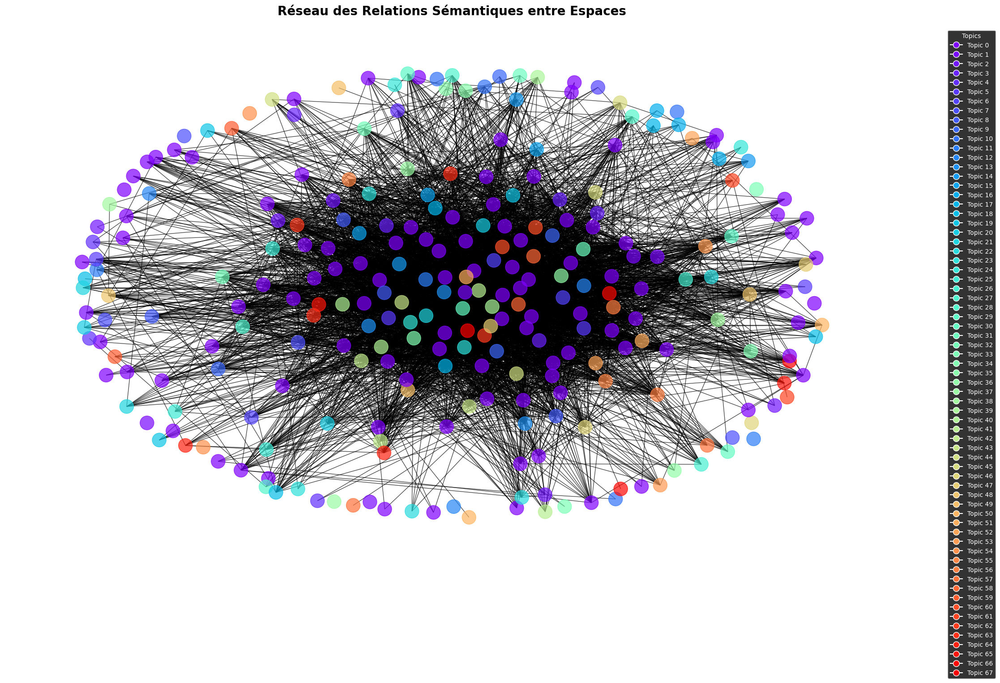


Statistiques du réseau:
Nombre de nœuds (espaces): 276
Nombre de connexions: 5417
Densité du réseau: 0.143


In [24]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import json
from collections import defaultdict

# Section 6 : Graphe des Relations Sémantiques entre Espaces
###########################################

print("\n=== Graphe des Relations Sémantiques entre Espaces ===")

# Vérifier les objets nécessaires
if 'topic_model_keybert' not in globals() or 'processed_df' not in globals():
    raise NameError("Erreur : topic_model_keybert ou processed_df non définis. Exécutez le pipeline principal d'abord.")

# Vérifier les colonnes
if 'topic_keybert' not in processed_df.columns or 'nom' not in processed_df.columns or 'texte' not in processed_df.columns:
    raise KeyError("Erreur : Les colonnes 'topic_keybert', 'nom' ou 'texte' sont absentes dans processed_df.")

# Convertir topic_keybert en int natif pour éviter les int64
processed_df['topic_keybert'] = processed_df['topic_keybert'].astype(int)

# Filtrer les documents (exclure topic -1)
filtered_df = processed_df[processed_df['topic_keybert'] != -1].reset_index(drop=True)
print(f"Nombre de documents après filtrage (excluant topic -1) : {len(filtered_df)}")

# Agréger les embeddings par espace (nom)
space_embeddings = defaultdict(list)
for idx, row in filtered_df.iterrows():
    space_embeddings[row['nom']].append(topic_model_keybert._extract_embeddings([row['texte']])[0])

# Calculer l'embedding moyen par espace
mean_space_embeddings = {space: np.mean(embeddings, axis=0) for space, embeddings in space_embeddings.items()}
spaces = list(mean_space_embeddings.keys())
space_vectors = np.array([mean_space_embeddings[space] for space in spaces])

# Calculer la similarité cosinus entre espaces
similarities_spaces = cosine_similarity(space_vectors)
print("Statistiques des similarités entre espaces:", np.min(similarities_spaces), np.max(similarities_spaces), np.mean(similarities_spaces))

# Construire le graphe
G_spaces = nx.Graph()
for i, space in enumerate(spaces):
    topic = filtered_df[filtered_df['nom'] == space]['topic_keybert'].iloc[0]  # Déjà converti en int
    G_spaces.add_node(i, space_name=space, topic=topic)

threshold = np.mean(similarities_spaces) + np.std(similarities_spaces)
print(f"Seuil de similarité calculé dynamiquement : {threshold:.3f}")

# Ajouter les arêtes
indices = np.where(similarities_spaces > threshold)
for idx in range(len(indices[0])):
    i, j = indices[0][idx], indices[1][idx]
    if i < j:  # Éviter les doublons
        G_spaces.add_edge(i, j, weight=float(similarities_spaces[i, j]))

# Sauvegarder les données pour React
nodes_data = [
    {"id": int(i), "space_name": data["space_name"], "topic": int(data["topic"])}  # Conversion explicite
    for i, data in G_spaces.nodes(data=True)
]
edges_data = [
    {"source": int(u), "target": int(v), "weight": float(data["weight"])}  # Conversion explicite
    for u, v, data in G_spaces.edges(data=True)
]
with open("semantic_network_spaces_data.json", "w", encoding="utf-8") as f:
    json.dump({"nodes": nodes_data, "edges": edges_data}, f, ensure_ascii=False, indent=4)
print("Données du graphe sauvegardées dans 'semantic_network_spaces_data.json'.")

# Visualisation
plt.figure(figsize=(20, 12), facecolor='white')
pos = nx.spring_layout(G_spaces, k=2, iterations=100)

topics = [G_spaces.nodes[n]['topic'] for n in G_spaces.nodes()]
unique_topics = list(set(topics))
colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_topics)))

with_labels = G_spaces.number_of_nodes() <= 30
nx.draw(G_spaces, pos,
        node_color=[colors[unique_topics.index(t)] for t in topics],
        node_size=500,
        alpha=0.7,
        with_labels=with_labels,
        labels={i: spaces[i][:20] for i in range(len(spaces))} if with_labels else None,
        font_size=8,
        font_color='black')

legend_elements = [plt.Line2D([0], [0], marker='o', color='w', 
                              markerfacecolor=colors[i], label=f'Topic {t}',
                              markersize=10)
                   for i, t in enumerate(unique_topics)]
plt.legend(handles=legend_elements, title='Topics', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title("Réseau des Relations Sémantiques entre Espaces", pad=20, fontsize=20, fontweight='bold', color='black')
plt.tight_layout()
plt.savefig('semantic_network_spaces.png', dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

print("\nStatistiques du réseau:")
print(f"Nombre de nœuds (espaces): {G_spaces.number_of_nodes()}")
print(f"Nombre de connexions: {G_spaces.number_of_edges()}")
print(f"Densité du réseau: {nx.density(G_spaces):.3f}")

Chaque espace est représenté par un nœud dans le graphe.
Chaque espace est associé à un topic, indiqué par sa couleur selon une palette rainbow (topics 0 à 67, hors -1).
Les arêtes sont ajoutées entre les nœuds (espaces) si la similarité cosinus entre les embeddings moyens des deux espaces dépasse un seuil calculé dynamiquement (0.490 dans ce cas).
Si deux espaces (nœuds) sont très similaires (similarité > 0.490), cela signifie que les textes associés à ces espaces partagent des sujets proches ou des thématiques communes.
Ce graphe représente les relations sémantiques entre les espaces en utilisant leurs embeddings moyens (générés par topic_model_keybert) et les similarités cosinus. Il visualise les connexions entre espaces similaires, les colore par topic, et fournit des statistiques utiles (nombre de nœuds : 220 d’après la sortie, nombre d’arêtes et densité à confirmer). La visualisation statique avec matplotlib et spring_layout est limitée par la densité (220 nœuds) et l’absence d’étiquettes claires pour un grand nombre de nœuds.